# Tarea 2: Segmentación

<a href="https://www.amazon.es/Hands-Unsupervised-Learning-Using-Python/dp/1492035645">Volver a Página Principal</a>

El objetivo de esta tarea es segmentar los clientes en diferentes grupos con el fin de poder conocer mejor a nuestra base de clientes para orientar nuestra actividad comercial. 

Estos grupos conocidos como clusters deberán ser homogéneos y distintos entre ellos. En otras palabras los miembros dentro de cada grupo deberán ser similar entre ellos pero a la vez muy distintos de los miembros de otro grupo (referencia: <a href="https://www.amazon.es/Hands-Unsupervised-Learning-Using-Python/dp/1492035645">Ankur A. Patel, Hands-On Unsupervised Learning Using Python</a>).

La información y descripción de cada cluster deberá ser observada en un dashboard donde se puedan apreciar las diferencias entre cada uno de los clusters, con el fin de poder extraer conclusiones.

In [115]:
from IPython.display import Image
PATH_DATA = "../input/easymoneygrupo5/"
try:
    Image(filename=PATH_DATA+'ML_canvas_2.png') 
except:
    pass

## Tabla de Contenidos <a class="anchor" id="0"></a>

1. [Data Preparation](#origin) <br> 
    1.1. [Salario (salary)](#11) <br> 
    1.2. [Fallecido (deceased)](#12) <br> 
    1.3. [Cliente activo (active_customer)](#13) <br> 
    1.4. [Edad (age)](#14) <br> 
    1.5. [Fecha de entrada (entry_date)](#15) <br> 
    1.6. [Género (gender)](#16) <br> 
    1.7. [Provincia (region_code)](#17) <br> 
    1.8. [País (country_id)](#18) <br> 
    1.9. [Domiciliaciones (payroll)](#19) <br> 
    1.10. [Productos](#110) <br> 
    - [Altas, bajas y cobros](#111) <br> 
    - [Customer Lifetime Value](#112) <br> 
    - [Permanencia](#113) <br> 
    - [Número de productos contratados](#114) <br> 
    - [Tiempo entre compras](#115) <br> 
2. [Data Cleaning](#2) <br> 
    2.1. [Feature Selection](#21) <br> 
3. [Model selection and construction](#3) <br> 
    3.1. [Selección del número óptimo de clusters](#31) <br> 
    3.2. [Clusterización y definición de los clusters](#32) <br> 
    3.3. [Evaluación de la clusterización](#33) <br> 
4. [Preparación del dashboard](#4) <br> 
5. [Conclusiones](#5) <br>


**Importamos librerías y dataset**

In [116]:
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

import os

import warnings
warnings.filterwarnings("ignore")

# time calculation to track some processes
import time

# python core library for machine learning and data science
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.impute import KNNImputer, SimpleImputer
from sklearn.cluster import KMeans

In [117]:
PATH_DATA = "../input/easymoneygrupo5/"
#PATH_DATA = '/content/drive/MyDrive/Nuclio Data Science - Proyecto Final/data/'
#PATH_DATA = '/Users/carlosperezricardo/Documents/data/'

In [118]:
commercial_activity = pd.read_csv(PATH_DATA+'commercial_activity_df.csv', encoding='utf-8')
commercial_activity.drop(columns=['Unnamed: 0'], inplace=True)

products = pd.read_csv(PATH_DATA+'products_df.csv', encoding='utf-8')
products.drop(columns=['Unnamed: 0'], inplace=True)

sociodemographic = pd.read_csv(PATH_DATA+'sociodemographic_df.csv', encoding='utf-8')
sociodemographic.drop(columns=['Unnamed: 0'], inplace=True)

Hacemos un join o merge de los 3 datasets uniendo por pk_cid y por pk_partition. Lo que resulta en un dataset de . Seguidamente se reduce el tamaño del dataset codificando como boolean las variables de productos que toman valores de 0 y 1. 

In [119]:
df_whole = pd.merge( commercial_activity, products, on = ['pk_cid','pk_partition'] )
df_whole = pd.merge( df_whole, sociodemographic, on=['pk_cid','pk_partition'] )

In [120]:
df_whole.shape

(5962924, 27)

In [121]:
df_whole.info(verbose=False)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5962924 entries, 0 to 5962923
Columns: 27 entries, pk_cid to salary
dtypes: float64(5), int64(15), object(7)
memory usage: 1.2+ GB


In [122]:
# Codificar variables logicas (1/0 = bool)
from sys import getsizeof

boolean_cols = ["short_term_deposit", "loans", "mortgage", "funds", "securities","long_term_deposit", "em_account_pp", "credit_card", "payroll_account", "emc_account", "debit_card", "em_account_p", "em_acount", "payroll", "pension_plan"] 
# payroll y pension_plan tienen nulos en el dataset completo

print('El dataset ocupa {:1f} MB'.format(df_whole.memory_usage(index=True).sum()/1048576))

for x in boolean_cols:
    df_whole[x] = df_whole[x].astype(bool)

print('El dataset ocupa {:1f} MB'.format(df_whole.memory_usage(index=True).sum()/1048576))

El dataset ocupa 1273.817993 MB
El dataset ocupa 676.715809 MB


In [123]:
df_whole.head(3).T

,0,1,2
pk_cid,1375586,1050611,1050612
pk_partition,2018-01-28,2018-01-28,2018-01-28
entry_date,2018-01-12,2015-08-10,2015-08-10
entry_channel,KHL,KHE,KHE
active_customer,1.0,0.0,0.0
segment,02 - PARTICULARES,03 - UNIVERSITARIO,03 - UNIVERSITARIO
short_term_deposit,False,False,False
loans,False,False,False
mortgage,False,False,False
funds,False,False,False


In [124]:
df_whole.columns.to_list()

['pk_cid',
 'pk_partition',
 'entry_date',
 'entry_channel',
 'active_customer',
 'segment',
 'short_term_deposit',
 'loans',
 'mortgage',
 'funds',
 'securities',
 'long_term_deposit',
 'em_account_pp',
 'credit_card',
 'payroll',
 'pension_plan',
 'payroll_account',
 'emc_account',
 'debit_card',
 'em_account_p',
 'em_acount',
 'country_id',
 'region_code',
 'gender',
 'age',
 'deceased',
 'salary']

Inicializamos un nuevo dataframe en el que se irá almacenando las columnas que se desean entrar en el modelo de clustering. 

In [125]:
df = pd.DataFrame()

# Data Preparation <a class="anchor" id="origin"></a>

En esta sección se preparan y limpian los datos para ser entrados en el modelo de segmentación.

## Salario (salary) <a class="anchor" id="11"></a>

[Tabla de Contenidos](#0)

Esta variable tiene muchos NaNs y su veracidad es cuestionable. El salario fue preguntando en una encuesta y según se tiene entendido no se comprobó, por lo que no se puede asegurar que estos valores sean verídicos. Cómo se determina a continuación la mediana de salario (de la unidad familiar) de los clientes con cuentas Universitarias es de alrededor de 80.000 euros, siendo España este resultado dista mucho de la realidad. 

Pese a esto, se probará realizar un cluster con esta variable. Para ello primero hay que darle un valor a los NaNs, una opción sería realizar un KNNImputer pero dada la larga cantidad de valores nulos y las dimensiones de la matriz, este proceso es muy largo por lo que se opta por poner la mediana de los salarios de cada segmento y para los que no tienen segmento la mediana de salarios global. 

In [126]:
salary_df = df_whole.groupby('pk_cid')[['segment','salary']].last()

In [127]:
salary_df['segment'].value_counts()

03 - UNIVERSITARIO    287582
02 - PARTICULARES     152468
01 - TOP                7573
Name: segment, dtype: int64

In [128]:
top_mean_salary = salary_df[ salary_df['segment'] == '01 - TOP' ]['salary'].median()
particulares_mean_salary = salary_df[ salary_df['segment'] == '02 - PARTICULARES' ]['salary'].median()
universitarios_mean_salary = salary_df[ salary_df['segment'] == '03 - UNIVERSITARIO' ]['salary'].median()
mean_salary = salary_df['salary'].median()

In [129]:
print('Salario mediana TOP '+str(top_mean_salary))
print('Salario mediana PARTICULARES '+str(particulares_mean_salary))
print('Salario mediana UNIVERSITARIOS '+str(universitarios_mean_salary))

Salario mediana TOP 121048.8
Salario mediana PARTICULARES 88606.78499999999
Salario mediana UNIVERSITARIOS 88614.87


In [130]:
salary_df['salary'] = np.where( (salary_df['salary'].isna()) & (salary_df['segment']=='01 - TOP'), top_mean_salary, salary_df['salary'] )
salary_df['salary'] = np.where( (salary_df['salary'].isna()) & (salary_df['segment']=='02 - PARTICULARES'), particulares_mean_salary, salary_df['salary'] )
salary_df['salary'] = np.where( (salary_df['salary'].isna()) & (salary_df['segment']=='03 - UNIVERSITARIO'), universitarios_mean_salary, salary_df['salary'] )
salary_df['salary'] = np.where( salary_df['salary'].isna(), mean_salary, salary_df['salary'] )

Guardamos los resultados de salario en el dataframe. Cómo se puede observar ya no hay nulos. 

In [131]:
df['salary'] = salary_df['salary']
df.isnull().sum()

salary    0
dtype: int64

## Fallecido (deceased) <a class="anchor" id="12"></a>

[Tabla de Contenidos](#0)

Al tener tan pocos valores distintos (es decir pocos fallecidos), se decide no entrar esta variable en el modelo.

In [132]:
df_whole.groupby('pk_cid')['deceased'].max().value_counts()

N    456244
S       129
Name: deceased, dtype: int64

In [133]:
df_whole['deceased'] = df_whole['deceased'].replace({'N':0,'S':1})
#df['deceased'] = df_whole.groupby('pk_cid')['deceased'].max()

## Cliente activo (active_customer) <a class="anchor" id="13"></a>

[Tabla de Contenidos](#0)

Esta variable *active_customer* indica si el cliente ha estado activo en los últimos 3 meses en las apps y la plataforma. Dado que tenemos la información de como máximo 17 históricos, hacer la media indica el grado de actividad de un cliente en toda su estancia en la empresa. 

Esta variable es guardada en el modelo de clustering. 

In [134]:
df['active_customer'] = df_whole.groupby('pk_cid')['active_customer'].mean()

## Edad (age) <a class="anchor" id="14"></a>

[Tabla de Contenidos](#0)

Esta variable nos ofrece la edad del cliente, variable que podría ser interesante para la clusterización. Nos quedamos con la última o con la edad más grande, en el caso de que esta varíe. 

In [135]:
df['age'] = df_whole.groupby('pk_cid')['age'].max()

## Fecha de entrada (entry_date) <a class="anchor" id="15"></a>

[Tabla de Contenidos](#0)

Fecha en la que realizó la primera contratación a través de easyMoney. De esta variable nos quedamos con el año de entrada. 

In [136]:
# hay errores en dias 29-02 deberian ser corregidos
df['entry_year'] = df_whole['entry_date'].apply( lambda x: str(x)[:4])

## Género (gender) <a class="anchor" id="16"></a>

[Tabla de Contenidos](#0)

No la utilizamos, dado que queremos realizar una clusterización lo más ética posible y no hacer distinciones ni por sexo ni raza. 

## Provincia (region_code) <a class="anchor" id="17"></a>

[Tabla de Contenidos](#0)

Esta variable indica la provincia de residencia de los clientes de España. Dado que el algoritmo que se desea implementar KMeans es geométrico, introducir tantas columnas como provincias tenemos (One Hot Encoding) no es para nada idóneo, dado que al augmentar las dimensiones aumentamos la distancia y los puntos cada vez están más alejados (<a href="https://www.iartificial.net/la-maldicion-de-la-dimension-en-machine-learning/">Maldición de la dimensionalidad</a>). La distancia media aumenta con el número de dimensiones.

Es por ello que si se desea entrar esta variable en el modelo deberá trabajarse con una sola columna y que ésta ofrezca información de manera ordinal o con sentido ordinal, es decir que para valores más grandes o más pequeños se espere un comportamiento o se tenga un significado para el negocio. Es por ello que hacer un LabelEncoder tampoco es interesante, porque qué diferencia de significado hay entre la región 28: Madrid y la 8: Barcelona; con la 13: Ciudad Real que está en medio pero dista mucho de la cantidad de clientes en las otras dos.

Se plantean 2 posibilidades para entrar esta variable al modelo:
- Codificar como 1 las regiones que más clientes tienen y el resto como 0. De esta manera el modelo diferenciará los clientes según si provienen de localidades como Madrid, Barcelona, Valencia, Sevilla... 
- Realizar un Frequency Encoding. Tiene el mismo fin, pero permite aumentar aún más la diferencia entre los clientes de cada provincia.

In [137]:
top_regions = df_whole.groupby('pk_cid')['region_code'].last().to_frame().value_counts().head(25)
list_top_regions = top_regions.reset_index()['region_code'].to_list()
top_regions
#list_top_regions

region_code
28.0           98252
8.0            46161
46.0           27711
30.0           21747
41.0           21312
15.0           18133
29.0           13591
3.0            13471
36.0           12659
11.0           11741
33.0           10127
50.0            9956
35.0            9479
6.0             8729
47.0            8410
45.0            7805
18.0            7709
37.0            6697
10.0            5808
14.0            5680
39.0            5468
7.0             5278
2.0             5237
13.0            5089
21.0            5049
dtype: int64

In [138]:
spanish_regions_code = {1:['Elciego', 'País Vasco'], 2:['Albacete', 'Castilla-La Mancha'], 3:['Alicante/Alacant', 'Com. Valenciana'],4:['Almería','Andalucía'],5:['Ávila','Castilla y León'], 6:['Badajoz','Extremadura'],	7:['Palma','Islas Baleares'], 8:['Barcelona','Cataluña'],9:['Burgos','Castilla y León'], 10: ['Cáceres','Extremadura'], 11: ['Cádiz','Andalucía'], 12: ['Castellón de la Plana/Castelló de la Plana','Com. Valenciana'], 13: ['Ciudad Real','Castilla-La Mancha'], 14: ['Córdoba','Andalucía'], 15: ['Coruña (A)','Galicia'], 16: ['Cuenca','Castilla-La Mancha'], 17: ['Girona','Cataluña'], 18: ['Granada','Andalucía'], 19: ['Guadalajara','Castilla-La Mancha'], 20: ['Donostia-San Sebastián','País Vasco'], 21: ['Huelva','Andalucía'], 22: ['Huesca','Aragón'], 23: ['Jaén','Andalucía'], 24: ['León','Castilla y León'], 25: ['Lleida','Cataluña'], 26: ['Logroño','La Rioja'], 27: ['Lugo','Galicia'], 28: ['Madrid','Madrid'], 29: ['Málaga','Andalucía'], 30: ['Murcia','Murcia'], 31: ['Pamplona/Iruña','Com. de Navarra'], 32: ['Ourense','Galicia'], 33: ['Oviedo','Princ. de Asturias'], 34: ['Palencia','Castilla y León'], 35: ['Palmas de Gran Canaria (Las)','Islas Canarias'], 36: ['Pontevedra','Galicia'], 37: ['Salamanca','Castilla y León'], 38: ['Santa Cruz de Tenerife','Islas Canarias'], 39: ['Santander','Cantabria'], 40: ['Segovia','Castilla y León'], 41: ['Sevilla','Andalucía'], 42: ['Soria','Castilla y León'], 43: ['Tarragona','Cataluña'], 44: ['Teruel','Aragón'], 45: ['Toledo','Castilla-La Mancha'], 46: ['Valencia','Com. Valenciana'], 47: ['Valladolid','Castilla y León'], 48: ['Bilbao','País Vasco'], 49: ['Zamora','Castilla y León'], 50: ['Zaragoza','Aragón'], 51: ['Ceuta','Ceuta y Melilla'], 52: ['Melilla','Ceuta y Melilla']}

In [139]:
spain = pd.DataFrame(spanish_regions_code).T
spain.columns = ['Ciudad','Com.Autonoma']
spain.reset_index(inplace=True)

In [140]:
top_regions = pd.DataFrame(list_top_regions, columns=['region_id'])
pd.merge(top_regions, spain, how='left', left_on='region_id', right_on='index')

,region_id,index,Ciudad,Com.Autonoma
0,28.0,28,Madrid,Madrid
1,8.0,8,Barcelona,Cataluña
2,46.0,46,Valencia,Com. Valenciana
3,30.0,30,Murcia,Murcia
4,41.0,41,Sevilla,Andalucía
5,15.0,15,Coruña (A),Galicia
6,29.0,29,Málaga,Andalucía
7,3.0,3,Alicante/Alacant,Com. Valenciana
8,36.0,36,Pontevedra,Galicia
9,11.0,11,Cádiz,Andalucía


In [141]:
# Codificar como 0 y 1
#df_whole['region_code'] = np.where( df_whole['region_code'].isin( list_top_regions ), True, False )
#df_whole.groupby('pk_cid')['region_code'].last().value_counts()

In [142]:
# Frequency encoding
df_whole['region_code'].fillna(-1, inplace=True)
freq_encoder = df_whole.groupby('pk_cid')['region_code'].last().to_frame().value_counts()
freq_encoder

region_code
 28.0          98248
 8.0           46159
 46.0          27711
 30.0          21747
 41.0          21309
 15.0          18132
 29.0          13591
 3.0           13471
 36.0          12659
 11.0          11741
 33.0          10126
 50.0           9956
 35.0           9479
 6.0            8729
 47.0           8410
 45.0           7805
 18.0           7709
 37.0           6697
 10.0           5808
 14.0           5680
 39.0           5468
 7.0            5276
 2.0            5237
 13.0           5089
 21.0           5049
 12.0           4984
 43.0           4653
 32.0           3866
 17.0           3840
 27.0           3731
 9.0            3563
 25.0           3407
 48.0           2941
 24.0           2758
 4.0            2646
 26.0           2601
 38.0           2587
 16.0           2516
 23.0           2455
 31.0           2354
 19.0           2341
 49.0           2206
 34.0           1993
 22.0           1624
 40.0           1605
 5.0            1551
 20.0           1541
 

In [143]:
df_whole['region'] = df_whole['region_code'].replace(freq_encoder)

In [144]:
df['region'] = df_whole.groupby('pk_cid')['region'].last()

## País (country_id) <a class="anchor" id="18"></a>

[Tabla de Contenidos](#0)

País de residencia del cliente. Dado que tan sólo hay 146 clientes que no son de España, y un cluster conteniendo tan pocos registros no es suficientemente grande, se opta por no entrar esta variable al modelo.

In [145]:
df_whole['country_id'] = np.where( df_whole['country_id'] == 'ES', True, False )
df_whole.groupby('pk_cid')['country_id'].last().value_counts()
#df['country'] = df_whole.groupby('pk_cid')['country_id'].last()

True     456209
False       164
Name: country_id, dtype: int64

## Domiciliaciones (payroll) <a class="anchor" id="19"></a>

[Tabla de Contenidos](#0)

Esta variable indica si el cliente tiene domiciliada alguna de las cuentas de la compañía, es decir que su salario se ingresa en alguna de nuestras cuentas. Dado que no hay ningún cliente con la cuenta domiciliada esta variable no se entra en el modelo. 

In [146]:
df_whole['payroll'] = np.where( df_whole['country_id'] == 'ES', True, False )
df_whole.groupby('pk_cid')['payroll'].max().value_counts()
#df['payroll'] = df_whole.groupby('pk_cid')['payroll'].last()

False    456373
Name: payroll, dtype: int64

## Productos <a class="anchor" id="110"></a>

[Tabla de Contenidos](#0)

Existen 14 productos de los que se pueden obtener diferentes métricas como altas, bajas, número de cobros, permanencia en cada uno de ellos, etc. Cómo se comentaba anteriormente con el fin de evitar la maldición de la dimensionalidad cuántas menos columnas mejor por lo que en esta sección se decidirá que variables resumen mejor el comportamiento de los clientes con los productos de la empresa. 

- cantidad de altas (17)
- cantidad de bajas sin cobro / altas que no han sido cobradas (17)
- cantidad de bajas con cobro (17)

# Por tipo de producto

- Cantidad de altas (3)
- Cantidad de bajas (3)

# Customer Lifetime Value

- Gastos totales de cada cliente (1)
- Gastos totales en cada tipo de producto (3)
- Numero de productos contratados en su historia (1)



In [147]:
customers = df.index
len(customers)

456373

In [148]:
partitions = ['2018-01-28','2018-02-28','2018-03-28','2018-04-28','2018-05-28','2018-06-28', \
    '2018-07-28','2018-08-28','2018-09-28','2018-10-28','2018-11-28','2018-12-28','2019-01-28', \
        '2019-02-28','2019-03-28','2019-04-28','2019-05-28']

list_products = ['short_term_deposit','loans','mortgage','funds','securities',
    'long_term_deposit','em_account_pp','credit_card','pension_plan',
    'payroll_account','emc_account','debit_card','em_account_p','em_acount']

products_dict = {"short_term_deposit":"ahorro e inversión", "loans":"financiación", "mortgage":"financiación", 
    "funds":"ahorro e inversión", "securities":"ahorro e inversión", "long_term_deposit":"ahorro e inversión", 
    "em_account_pp":"cuenta", "credit_card":"financiación", "payroll_account":"cuenta", "pension_plan":"ahorro e inversión", 
    "emc_account":"cuenta", "debit_card":"financiación", "em_account_p":"cuenta", "em_acount":"cuenta"}

cost_product = {'cuenta':10, 'ahorro e inversión':40, 'financiación':60}

### Altas, bajas y cobros <a class="anchor" id="111"></a>

[Tabla de Contenidos](#0)

En este apartado se crean una serie de funciones que permiten obtener las altas, bajas y cobros de cada cliente. Con el fin de ilustrar el funcionamiento y comprobar que el resultado que devuelve es correcto, se han desarollado las funciones *determinar_altas*, *determinar_bajas* y *determinar_cobros*. Las versiones *_all* incluyen estos cálculos pero lo calculan en todo el dataset. 

In [149]:
def determinar_altas(data):
    data = pd.DataFrame(data)
    data.columns=['product']
    data['prev'] = data['product'].shift(1)
    data['diff'] = data['product'] - data['prev']

    return len(data[data['diff'] == 1])

Se evalúa el correcto funcionamiento de la función con un dataset de test. 

In [150]:
test_data = pd.DataFrame( [0,0,1,1,1,0,0,0,1,1,1,1,0,0,0,1] )
determinar_altas(test_data)
# expected result: 3

3

In [151]:
def determinar_bajas(data):
    data = pd.DataFrame(data)
    data.columns=['product']
    data['prev'] = data['product'].shift(1)
    data['diff'] = data['product'] - data['prev']

    return len(data[data['diff'] == -1])

In [152]:
test_data = pd.DataFrame( [0,0,1,1,1,0,0,0,1,1,1,1,0,0,0,0,0] )
determinar_bajas(test_data)
# expected result: 2

2

Se debe prestar atención para el caso de los cobros o altas cobradas. Dado que se debe cumplir que la permanencia sea de almenos 3 meses para así poder cobrar el producto al cliente y que en la primera partición se desconoce el estado anterior de los productos, se definen 3 posibles casos que deben ser comprobados. 

In [153]:
def determinar_altas_cobradas(data):
    data = pd.DataFrame(data)
    data.reset_index(inplace=True)

    data.columns=['pk_partition','product']
    
    data['prev_month1'] = data['product'].shift(1)
    data['prev_month2'] = data['product'].shift(2)
    data['prev_month3'] = data['product'].shift(3)

    data.fillna(-2, inplace=True)

    # nuevas contrataciones (ya cobrados - llevan 3 meses y no se han dado de baja)
    #cond3 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) &\
    #    ((data['prev_month3']==0) | ((data['prev_month3'] == -2) & (data['pk_partition']!='2018-03-28')))
    
    cond1 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) & (data['prev_month3']==0)
    cond2 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) & (data['prev_month3']==-2) & (data['pk_partition']!='2018-03-28')

    cond3 = cond1 | cond2
    print(data)
    contrataciones_cobradas = data[ cond3 ] 

    return len(contrataciones_cobradas)

In [154]:
test_data = pd.DataFrame( [0,0,1,1,1,1,0,0,1,1,0,0,0,0,0,1,1], index=partitions )
test_data.reset_index(inplace=True)
test_data.columns = ['pk_partition','product']
test_data['pk_partition'] = pd.to_datetime( test_data['pk_partition'] )
test_data.set_index('pk_partition',inplace=True)

determinar_altas_cobradas(test_data)
# expected result: 1

   pk_partition  product  prev_month1  prev_month2  prev_month3
0    2018-01-28        0         -2.0         -2.0         -2.0
1    2018-02-28        0          0.0         -2.0         -2.0
2    2018-03-28        1          0.0          0.0         -2.0
3    2018-04-28        1          1.0          0.0          0.0
4    2018-05-28        1          1.0          1.0          0.0
5    2018-06-28        1          1.0          1.0          1.0
6    2018-07-28        0          1.0          1.0          1.0
7    2018-08-28        0          0.0          1.0          1.0
8    2018-09-28        1          0.0          0.0          1.0
9    2018-10-28        1          1.0          0.0          0.0
10   2018-11-28        0          1.0          1.0          0.0
11   2018-12-28        0          0.0          1.0          1.0
12   2019-01-28        0          0.0          0.0          1.0
13   2019-02-28        0          0.0          0.0          0.0
14   2019-03-28        0          0.0   

1

In [155]:
test_data = pd.DataFrame( [1,1,1,1,0,1,0,0,1,1,1,1,0,0,1,1,1], index=partitions )
test_data.reset_index(inplace=True)
test_data.columns = ['pk_partition','product']
test_data['pk_partition'] = pd.to_datetime( test_data['pk_partition'] )
test_data.set_index('pk_partition',inplace=True)

determinar_altas_cobradas(test_data)
# expected result: 2

   pk_partition  product  prev_month1  prev_month2  prev_month3
0    2018-01-28        1         -2.0         -2.0         -2.0
1    2018-02-28        1          1.0         -2.0         -2.0
2    2018-03-28        1          1.0          1.0         -2.0
3    2018-04-28        1          1.0          1.0          1.0
4    2018-05-28        0          1.0          1.0          1.0
5    2018-06-28        1          0.0          1.0          1.0
6    2018-07-28        0          1.0          0.0          1.0
7    2018-08-28        0          0.0          1.0          0.0
8    2018-09-28        1          0.0          0.0          1.0
9    2018-10-28        1          1.0          0.0          0.0
10   2018-11-28        1          1.0          1.0          0.0
11   2018-12-28        1          1.0          1.0          1.0
12   2019-01-28        0          1.0          1.0          1.0
13   2019-02-28        0          0.0          1.0          1.0
14   2019-03-28        1          0.0   

2

In [156]:
test_data = pd.DataFrame( [1,1,1,1,0,1,0,0,1,1,1,1,0], index=partitions[4:] )
test_data.reset_index(inplace=True)
test_data.columns = ['pk_partition','product']
test_data['pk_partition'] = pd.to_datetime( test_data['pk_partition'] )
test_data.set_index('pk_partition',inplace=True)

determinar_altas_cobradas(test_data)
# expected result: 2

   pk_partition  product  prev_month1  prev_month2  prev_month3
0    2018-05-28        1         -2.0         -2.0         -2.0
1    2018-06-28        1          1.0         -2.0         -2.0
2    2018-07-28        1          1.0          1.0         -2.0
3    2018-08-28        1          1.0          1.0          1.0
4    2018-09-28        0          1.0          1.0          1.0
5    2018-10-28        1          0.0          1.0          1.0
6    2018-11-28        0          1.0          0.0          1.0
7    2018-12-28        0          0.0          1.0          0.0
8    2019-01-28        1          0.0          0.0          1.0
9    2019-02-28        1          1.0          0.0          0.0
10   2019-03-28        1          1.0          1.0          0.0
11   2019-04-28        1          1.0          1.0          1.0
12   2019-05-28        0          1.0          1.0          1.0


2

Seguidemente se presentan las versiones _all y se calculan en el dataset de clientes. Este proceso suele tardar bastante por lo que se guarda en un pickle y así no se debe ejecutar esta parte del código cada vez que queramos obtener un modelo.

In [157]:
def determinar_altas_all(data):
    data.columns=['pk_partition','pk_cid','product']
    data['prev'] = data.groupby('pk_cid')['product'].shift(1)
    data['diff'] = data['product'] - data['prev']

    # Solo queremos 1 
    data['diff'] = np.where( (data['product']==1) & (data['diff'].isna()) & (data['pk_partition']!='2018-01-28'), 1, data['diff'] )
    data['diff'].fillna(0,inplace=True)
    data['diff'] = np.where( data['diff'] == -1, 0, data['diff'] )

    return data.groupby('pk_cid')['diff'].sum()

In [158]:
def determinar_bajas_all(data):
    data.columns=['pk_cid','product']
    data['prev'] = data.groupby('pk_cid')['product'].shift(1)
    data['diff'] = data['product'] - data['prev']

    # Solo queremos -1 
    data['diff'].fillna(0,inplace=True)
    data['diff'] = np.where( data['diff'] == 1, 0, data['diff'] )
    data['diff'] = np.where( data['diff'] == -1, 1, data['diff'] )

    return data.groupby('pk_cid')['diff'].sum()

In [159]:
def determinar_altas_cobradas_all(data):
    data.columns=['pk_partition','pk_cid','product']

    data['prev_month1'] = data.groupby('pk_cid')['product'].shift(1)
    data['prev_month2'] = data.groupby('pk_cid')['product'].shift(2)
    data['prev_month3'] = data.groupby('pk_cid')['product'].shift(3)

    data.fillna(-2, inplace=True)

    # nuevas contrataciones (ya cobrados - llevan 3 meses y no se han dado de baja)
    #cond3 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) &\
    #    ((data['prev_month3']==0) | ((data['prev_month3'] == -2) & (data['pk_partition']!='2018-03-28')))

    cond31 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) & (data['prev_month3']==0)
    cond32 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) & (data['prev_month3']==-2) & (data['pk_partition']!='2018-03-28')
    cond33 = (data['product']==1) & (data['prev_month1']==1) & (data['prev_month2']==1) & (data['prev_month3']==1) & (data['pk_partition']=='2018-03-28')
    
    cond3 = cond31 | cond32 | cond33

    data['comprado'] = cond3

    return data.groupby('pk_cid')['comprado'].sum()

In [160]:
df_whole = df_whole.sort_values(['pk_partition','pk_cid'], ascending=True)

In [161]:
if not os.path.isfile(os.path.join(PATH_DATA, "ALTAS_BAJAS_COBROS.pkl")):
    new_cols = []
    for prod in list_products:
        df[prod+'_altas'] = determinar_altas_all( df_whole[['pk_partition','pk_cid',prod]] )
        df[prod+'_bajas'] = determinar_bajas_all( df_whole[['pk_cid',prod]] )
        df[prod+'_cobros'] = determinar_altas_cobradas_all( df_whole[['pk_partition','pk_cid',prod]] )

        new_cols.append(prod+'_altas')
        new_cols.append(prod+'_bajas')
        new_cols.append(prod+'_cobros')

        print(prod)
        new_cols 
        df[new_cols].reset_index().to_pickle("ALTAS_BAJAS_COBROS.pkl")
else:
    altas_bajas_cobros = pd.read_pickle(os.path.join(PATH_DATA,"ALTAS_BAJAS_COBROS.pkl"))
    df = pd.merge(df.reset_index(), altas_bajas_cobros, on='pk_cid', how='left')
    df.set_index('pk_cid',inplace=True)

In [162]:
df.head(3).T

pk_cid,15891,16063,16203
salary,88606.785,88606.785,121048.8
active_customer,0.5,0.714286,0.833333
age,59,62,70
entry_year,2015,2015,2015
region,98248.0,98248.0,46159.0
short_term_deposit_altas,0,0,0
short_term_deposit_bajas,0,0,0
short_term_deposit_cobros,0,0,0
loans_altas,0,0,0
loans_bajas,0,0,0


El siguiente paso es agrupar la información de los productos por tipo de producto, es decir agrupamos las cuentas en cuenta_altas, cuenta_bajas y cuenta_cobros; reduciendo así el número de columnas. 

In [163]:
init_cols = ['ahorros_altas','ahorros_bajas','ahorros_cobros',
    'financiacion_altas','financiacion_bajas','financiacion_cobros',
    'cuenta_altas','cuenta_bajas','cuenta_cobros',
    'unique_altas','recurrencia']
    
for col in init_cols:
    df[col] = 0


for key, value in products_dict.items():
    # corregimos titulos largos y con tildes
    if value == 'ahorro e inversión':
        value = 'ahorros'
    elif value == 'financiación':
        value = 'financiacion'
    elif value == 'cuenta':
        value = 'cuenta'

    df[value+'_altas'] += df[key+'_altas'] 
    df[value+'_bajas'] += df[key+'_bajas'] 
    df[value+'_cobros'] += df[key+'_cobros'] 
    
    df['unique_altas'] += np.where( df[key+'_altas'] != 0, 1, 0)
    df['recurrencia'] += np.where(df[key+'_altas'] >= 2, df[key+'_altas'], 0)
    
    #df.drop(key+'_altas', axis=1, inplace=True)
    #df.drop(key+'_bajas', axis=1, inplace=True)
    #df.drop(key+'_cobros', axis=1, inplace=True)

df['total_altas'] = df['ahorros_altas'] + df['financiacion_altas'] + df['cuenta_altas']

In [164]:
df.head(5).T

pk_cid,15891,16063,16203,16502,17457
salary,88606.785,88606.785,121048.8,88606.785,102405.75
active_customer,0.5,0.714286,0.833333,0.888889,1.0
age,59,62,70,58,54
entry_year,2015,2015,2015,2015,2015
region,98248.0,98248.0,46159.0,98248.0,98248.0
short_term_deposit_altas,0,0,0,0,0
short_term_deposit_bajas,0,0,0,0,0
short_term_deposit_cobros,0,0,0,0,0
loans_altas,0,0,0,0,0
loans_bajas,0,0,0,0,0


In [165]:
assert len(df[ df['total_altas'] < df['unique_altas']]) == 0

### Customer Lifetime Value <a class="anchor" id="112"></a>

[Tabla de Contenidos](#0)

Cómo se comenta en la <a href="https://www.inboundcycle.com/blog-de-inbound-marketing/customer-lifetime-value-cltv-como-calcularlo">Tarea 1 (OJO! PONER LINK BIEN!)</a>, el <a href="https://www.inboundcycle.com/blog-de-inbound-marketing/customer-lifetime-value-cltv-como-calcularlo">Customer Lifetime Value</a> (CLV) o valor del tiempo de vida del cliente es un pronóstico sobre la cantidad de dinero que espera recibir la empresa por parte de un usuario, durante todo el tiempo en que este siga siendo su cliente.

En esta sección se calcula el dinero gastado por cada cliente. Nótese que esta variable lleva oculta parte de la información de los cobros de los clientes. Por lo que más adelante se determinará que variable entrar si la cantidad de cobros totales, la cantidad de cobros en cada tipo de producto o el dinero gastado.

In [166]:
for key, value in cost_product.items():
    if key == 'ahorro e inversión':
        key = 'ahorros'
    elif key == 'financiación':
        key = 'financiacion'
    elif key == 'cuenta':
        key = 'cuenta'

    if 'gastado' not in df.columns:
        df['gastado'] = df[key+'_cobros']*value
    else:
        df['gastado'] += df[key+'_cobros']*value

    #df['bajas'] += df[key+'_bajas']
    #df.drop(key+'_bajas', axis=1, inplace=True)
    #df.drop(key+'_cobros', axis=1, inplace=True)

In [167]:
len(df.columns)

60

In [168]:
products_dict = {"short_term_deposit":"ahorro e inversión", "loans":"financiación", "mortgage":"financiación", 
    "funds":"ahorro e inversión", "securities":"ahorro e inversión", "long_term_deposit":"ahorro e inversión", 
    "em_account_pp":"cuenta", "credit_card":"financiación", "payroll_account":"cuenta", "pension_plan":"ahorro e inversión", 
    "emc_account":"cuenta", "debit_card":"financiación", "em_account_p":"cuenta", "em_acount":"cuenta"}

ahorros = ["pk_partition","short_term_deposit","funds","securities","long_term_deposit","pension_plan"]
cuentas = ["pk_partition","em_acount","em_account_pp","emc_account","em_account_p","em_account_pp","payroll_account"]
financiacion = ["pk_partition","short_term_deposit","funds","securities","long_term_deposit","pension_plan"]

In [169]:
df_whole[ df_whole['pk_cid'] == 16203 ][cuentas]
# cuentas: altas = 1, cobradas = 1, bajas = 0

,pk_partition,em_acount,em_account_pp,emc_account,em_account_p,em_account_pp,payroll_account
3628238,2018-12-28,False,False,False,False,False,False
4028170,2019-01-28,True,False,False,False,False,False
4480636,2019-02-28,True,False,False,False,False,False
4876039,2019-03-28,True,False,False,False,False,False
5134321,2019-04-28,True,False,False,False,False,False
5523396,2019-05-28,True,False,False,False,False,False


In [170]:
df_whole[ df_whole['pk_cid'] == 15891 ][cuentas]
# cuentas: altas = 1, cobradas = 0, bajas = 1

,pk_partition,em_acount,em_account_pp,emc_account,em_account_p,em_account_pp,payroll_account
1479563,2018-07-28,True,False,False,False,False,False
2168122,2018-08-28,False,False,False,False,False,False


### Permanencia <a class="anchor" id="113"></a>

[Tabla de Contenidos](#0)

Similarmente a las altas, bajas y cobros es posible determinar la permanencia de cada cliente en cada producto. Sin embargo, esta métrica presenta una gran desventaja respecto a las otras. Cómo guardo una permanencia de un cliente que se ha dado de alta 2 veces con un mismo producto y cómo contabilizo las permanencias de varios productos. 

Es por ello, que se define la permanencia como la suma de permanencias medias en un mismo producto y en todos los productos. Nótese que tan sólo se contabilizan los productos que se han contratado. 

$$permanencia = \frac{ \frac{\sum perm_i} {m}  } { N } $$

Siendo $perm_i$ el número de meses con el producto, m el número de altas en ese producto y N el número de productos dados de alta alguna vez. 

In [171]:
def determinar_permanencia(data):
    data = pd.DataFrame(data)
    data.reset_index(inplace=True)

    data.columns=['pk_partition','product']

    data['diff'] = data['product'].diff()

    data['prev'] = np.where( (data['diff'].isna()) & (data['product'] == 1), 1, 0 )
    data = data[ data['diff'] != 0 ]

    data['date_diff'] = round(data['pk_partition'].diff()/np.timedelta64(1, 'M'))

    return data[data['diff'] == -1]

In [172]:
test_data = pd.DataFrame( [0,0,1,1,1,0,0,0,1,1,1,1,0,0,0,1,1], index=partitions )
test_data.reset_index(inplace=True)
test_data.columns = ['pk_partition','product']
test_data['pk_partition'] = pd.to_datetime( test_data['pk_partition'] )
test_data.set_index('pk_partition',inplace=True)

perm = determinar_permanencia(test_data)
print(perm)

perm['date_diff'].sum()/len(perm['date_diff'])
# expected result: 3, 4

   pk_partition  product  diff  prev  date_diff
5    2018-06-28        0  -1.0     0        3.0
12   2019-01-28        0  -1.0     0        4.0


3.5

En el código anterior se testea un caso y se observa que el cliente estuvo 3 y 4 meses con el producto dándose 2 veces de alta, la media es 3.5. 

In [173]:
def determinar_permanencia_all(data):
    data.columns=['pk_partition','pk_cid','product']
    data['pk_partition'] = pd.to_datetime(data['pk_partition'])

    data['prev'] = data.groupby('pk_cid')['product'].shift(1)
    data['diff'] = data['product'] - data['prev']
    #data['diff'] = data['product'].diff()

    data['prev'] = np.where( (data['diff'].isna()) & (data['product'] == 1), 1, 0 )
    data = data[ data['diff'] != 0 ]
    
    data = data.sort_values(['pk_cid','pk_partition'])
    
    data['date_diff'] = round(data['pk_partition'].diff()/np.timedelta64(1, 'M'))

    data = data[data['diff'] == -1]
    
    #print(data)
    summary = data.groupby('pk_cid')['date_diff'].agg(['sum','count'])
    summary['result'] = summary['sum']/summary['count']
    summary.reset_index(inplace=True)
    #print(summary)

    return summary[['pk_cid','result']]

In [174]:
list_perms = []
for prod in list_products:
    perms = determinar_permanencia_all( df_whole[['pk_partition','pk_cid',prod]] )
    #print(perms)
    perms.columns = ['pk_cid',prod+'_perm']
    df = pd.merge(df, perms, how='left', on='pk_cid')
    list_perms.append(prod+'_perm')
    print(prod)

short_term_deposit
loans
mortgage
funds
securities
long_term_deposit
em_account_pp
credit_card
pension_plan
payroll_account
emc_account
debit_card
em_account_p
em_acount


In [175]:
df['permanencia'] = df[list_perms].sum(axis=1)/df[list_perms].count(axis=1)
df['permanencia'].value_counts(dropna=False)

NaN         375200
1.000000     14892
2.000000      8109
3.000000      7097
4.000000      4254
             ...  
1.933333         1
3.866667         1
1.083333         1
1.642857         1
5.095238         1
Name: permanencia, Length: 675, dtype: int64

In [176]:
df['permanencia'].fillna(0, inplace=True)

In [177]:
df.drop(list_perms, axis=1, inplace=True)

### Número de productos distintos contratados <a class="anchor" id="114"></a>

[Tabla de Contenidos](#0)

También se pueden obtener el número de productos totales contratados por cada cliente.

In [178]:
df['total_products'] = df_whole.groupby('pk_cid')[list_products].max().sum(axis=1).reset_index(drop=True)

In [179]:
df['total_products']

0         1
1         0
2         1
3         2
4         3
         ..
456368    0
456369    0
456370    0
456371    0
456372    0
Name: total_products, Length: 456373, dtype: int64

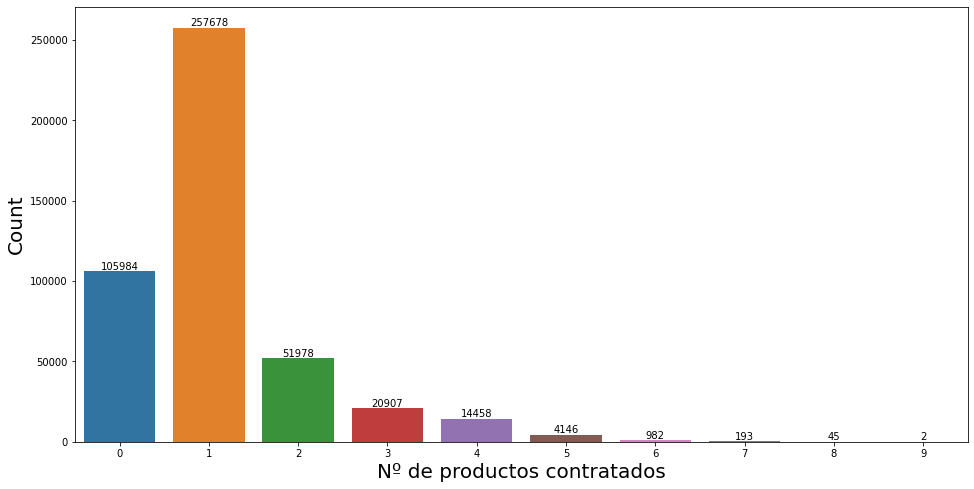

In [180]:
fig, ax = plt.subplots(figsize=(16,8))
sns.countplot(df['total_products'])
ax.set_ylabel('Count',fontsize = 20)
ax.set_xlabel('Nº de productos contratados',fontsize = 20)

for p in ax.patches:
    percentage = '{}'.format(p.get_height())
    x = p.get_x() + p.get_width()
    y = p.get_height()
    ax.annotate(percentage, (x-0.4, y+1200),ha='center')
    
plt.show()

#fig = px.histogram(df, x='total_products')
#fig.show()

Esta gráfica es guardada como png y será incluida en el dashboard de la Tarea 1. 

In [181]:
obtain = True
if obtain == True:
    fig.savefig('num_productos_contratados.png')

### Tiempo entre compras  <a class="anchor" id="115"></a>

[Tabla de Contenidos](#0)

En esta sección final se calcula el tiempo entre compras para cada cliente. Al igual que en permanencia se escoge la media. En este caso hay que tener en cuenta que las compras pueden producirse en varios productos, por lo que el tiempo entre compras puede ser entre compras dentro de un mismo producto o entre compras de distintos productos.

Primeramente, se genera una dataset de test y se comprueba que los resultados obtenidos son satisfactorios. 

In [182]:
test_data = pd.DataFrame( [0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,1,1], index=partitions )
test_data.reset_index(inplace=True)
test_data.columns = ['pk_partition','product1']
test_data['product2'] = [0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0]
test_data
# expected result: 2, 2, 11

,pk_partition,product1,product2
0,2018-01-28,0,0
1,2018-02-28,0,0
2,2018-03-28,1,0
3,2018-04-28,1,0
4,2018-05-28,1,1
5,2018-06-28,0,1
6,2018-07-28,0,1
7,2018-08-28,0,0
8,2018-09-28,0,0
9,2018-10-28,0,0


In [183]:
test_data['pk_partition'] = pd.to_datetime(test_data['pk_partition'])
test_data['diff1'] = test_data['product1'].diff()
test_data['diff2'] = test_data['product2'].diff()

list_diffs = ['diff1','diff2']

test_data['diff'] = test_data[list_diffs].max(axis=1)
only_altas = test_data[ test_data['diff'] == 1 ]

only_altas['prev_date'] = only_altas['pk_partition'].shift(1)
only_altas['prev_date'].fillna( test_data['pk_partition'][0],inplace=True)
only_altas['diff_date'] = round((only_altas['pk_partition'] - only_altas['prev_date'])/np.timedelta64(1, 'M'))
only_altas

,pk_partition,product1,product2,diff1,diff2,diff,prev_date,diff_date
2,2018-03-28,1,0,1.0,0.0,1.0,2018-01-28,2.0
4,2018-05-28,1,1,0.0,1.0,1.0,2018-03-28,2.0
15,2019-04-28,1,0,1.0,0.0,1.0,2018-05-28,11.0


Una vez comprobado el correcto funcionamiento, se calcula el tiempo entre compras de cada cliente considerando todos los productos. Para ello se hace una copia del dataframe original y por otro lado también se calcula cuál es la primera partición de cada cliente.

In [184]:
# Ahora por cliente y todos los productos 
df_ = df_whole.copy(deep=True)

In [185]:
df_['pk_partition'] = pd.to_datetime(df_['pk_partition'])
list_diffs = []

for prod in list_products:
    df_['diff_'+prod] = df_[prod] - df_.groupby('pk_cid')[prod].shift(1) 
    list_diffs.append('diff_'+prod)
    
df_['diff'] = df_[list_diffs].max(axis=1)
df_.drop(list_diffs, axis=1, inplace=True)

In [186]:
only_altas = df_[ df_['diff'] == 1 ]
only_altas['prev_date'] = only_altas.groupby('pk_cid')['pk_partition'].shift(1)

In [187]:
df_ = df_.sort_values(['pk_cid','pk_partition'])
first_partitions = df_.groupby('pk_cid').first()['pk_partition']
first_partitions = first_partitions.to_frame().reset_index()
first_partitions.columns = ['pk_cid','first_partition']
first_partitions.head(5)

,pk_cid,first_partition
0,15891,2018-07-28
1,16063,2018-11-28
2,16203,2018-12-28
3,16502,2018-09-28
4,17457,2018-01-28


In [188]:
only_altas = pd.merge(only_altas, first_partitions, how='left', on='pk_cid')
#only_altas
#only_altas['diff_date'] = round((only_altas['pk_partition'] - only_altas['prev_date'])/np.timedelta64(1, 'M'))

#only_altas['prev_date'] = np.where( only_altas['prev_date'].isna(), only_altas['first_partition'], 0 )
#only_altas['prev_date'].isna()
only_altas['prev_date'] = only_altas[['prev_date','first_partition']].max(axis=1)

In [189]:
only_altas['diff_date'] = round((only_altas['pk_partition'] - only_altas['prev_date'])/np.timedelta64(1, 'M'))
only_altas['diff_date'] = np.where( only_altas['pk_partition'] == only_altas['prev_date'], 0, only_altas['diff_date'] ) 
# no nos quedamos con las primeras compras, no tiene sentido calcular el tiempo entre compras
only_altas = only_altas[only_altas['diff_date'] != 0]

In [190]:
only_altas.head(3).T

,0,1,2
pk_cid,31624,31825,37299
pk_partition,2018-02-28 00:00:00,2018-02-28 00:00:00,2018-02-28 00:00:00
entry_date,2017-11-26,2015-09-14,2018-01-27
entry_channel,KAT,KAT,KHK
active_customer,1.0,1.0,1.0
segment,02 - PARTICULARES,01 - TOP,01 - TOP
short_term_deposit,False,False,True
loans,False,False,False
mortgage,False,False,False
funds,False,False,False


In [191]:
result = only_altas.groupby('pk_cid')['diff_date'].agg(['sum','count','max','min','mean'])

In [192]:
tiempo_entre_compras = pd.DataFrame(result['mean']).reset_index()
tiempo_entre_compras.columns = ['pk_cid','tiempo_entre_compras']

df = pd.merge(df, tiempo_entre_compras, how='left', on='pk_cid')

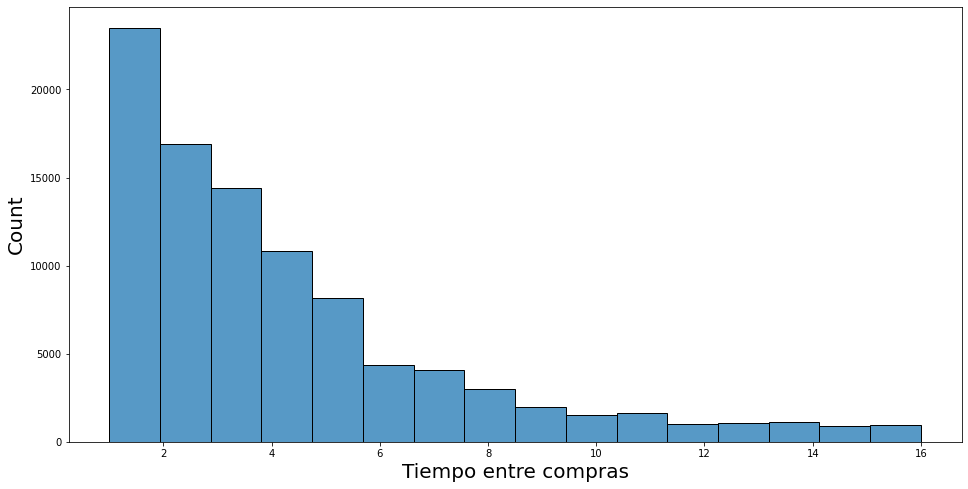

In [193]:
fig, ax = plt.subplots(figsize=(16,8))
sns.histplot(tiempo_entre_compras['tiempo_entre_compras'], bins=16)
ax.set_ylabel('Count',fontsize = 20)
ax.set_xlabel('Tiempo entre compras',fontsize = 20)
plt.show()

In [194]:
obtain = True
if obtain == True:
    fig.savefig('tiempo_compras.png')

La siguiente pregunta es saber qué hacemos con los clientes que no han comprado nada, que tiempo de compras establecemos. En este caso se opta por el valor máximo de 17 meses. 

In [195]:
#Que hacemos con en el tiempo de compras de clientes que no han comprado?
df['tiempo_entre_compras'].fillna(17, inplace=True)
df['tiempo_entre_compras'].isnull().sum()

0

# Data Cleaning <a class="anchor" id="2"></a>

[Tabla de Contenidos](#0)

Finalmente se limpia el dataframe con los datos que se desean entrar al modelo. Primeramente se eliminan todas las columnas de altas, bajas y cobros por productos. Como se realizaba anteriormente, estas columnas son agrupadas por tipo de producto. 

Y seguidamente se computan las bajas totales siendo esto la suma de todas las bajas en todos los productos o la suma de todas las bajas en todos los tipo de producto. 


In [196]:
# drop de columnas de altas, bajas y cobros por cada producto
for key, value in products_dict.items():
    df.drop(key+'_altas', axis=1, inplace=True)
    df.drop(key+'_bajas', axis=1, inplace=True)
    df.drop(key+'_cobros', axis=1, inplace=True)

In [197]:
df['bajas'] = df['ahorros_bajas'] + df['financiacion_bajas'] + df['cuenta_bajas'] 

df['ing_potencial'] = df['ahorros_altas']*40 + df['financiacion_altas']*60 + df['cuenta_altas']*10   
df['conversion'] = df['gastado'] / df['ing_potencial'] 

df.replace([np.inf, -np.inf], np.nan, inplace=True)

df['altas'] = df['ahorros_altas'] + df['financiacion_altas'] + df['cuenta_altas']
#df['recurrencia'] = df['altas'] / df['unique_altas'] - 1

df['conversion'].fillna(0,inplace=True)
#df['recurrencia'].fillna(0,inplace=True)

In [198]:
df.head(5).T

,0,1,2,3,4
pk_cid,15891,16063,16203,16502,17457
salary,88606.785,88606.785,121048.8,88606.785,102405.75
active_customer,0.5,0.714286,0.833333,0.888889,1.0
age,59,62,70,58,54
entry_year,2015,2015,2015,2015,2015
region,98248.0,98248.0,46159.0,98248.0,98248.0
ahorros_altas,0,0,0,0,1
ahorros_bajas,0,0,0,0,1
ahorros_cobros,0,0,0,0,1
financiacion_altas,0,0,0,0,5


El siguiente paso es observar que las variables de un mismo tipo de producto están muy correlacionadas. Es normal que si un cliente se da mucho de alta en ahorros, se dé mucho de baja en ahorros, y que los cobros también tengan una correlación fuerte. 

In [199]:
redundant_cols = ['altas','ahorros_altas','ahorros_bajas','ahorros_cobros','financiacion_altas','financiacion_bajas','financiacion_cobros',
                  'cuenta_altas','cuenta_bajas','cuenta_cobros','unique_altas','total_products','bajas','gastado','recurrencia']
corr = df[redundant_cols].corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(3)

,altas,ahorros_altas,ahorros_bajas,ahorros_cobros,financiacion_altas,financiacion_bajas,financiacion_cobros,cuenta_altas,cuenta_bajas,cuenta_cobros,unique_altas,total_products,bajas,gastado,recurrencia
altas,1.000,0.652,0.539,0.541,0.712,0.592,0.550,0.741,0.563,0.638,0.908,0.743,0.814,0.768,0.769
ahorros_altas,0.652,1.000,0.857,0.801,0.219,0.161,0.230,0.329,0.352,0.274,0.587,0.582,0.586,0.585,0.517
ahorros_bajas,0.539,0.857,1.000,0.605,0.199,0.178,0.187,0.233,0.310,0.198,0.438,0.514,0.632,0.450,0.503
ahorros_cobros,0.541,0.801,0.605,1.000,0.186,0.129,0.204,0.290,0.281,0.256,0.539,0.527,0.437,0.654,0.356
financiacion_altas,0.712,0.219,0.199,0.186,1.000,0.903,0.650,0.193,0.216,0.168,0.495,0.503,0.711,0.583,0.761
financiacion_bajas,0.592,0.161,0.178,0.129,0.903,1.000,0.445,0.102,0.193,0.080,0.343,0.413,0.750,0.393,0.731
financiacion_cobros,0.550,0.230,0.187,0.204,0.650,0.445,1.000,0.233,0.219,0.212,0.487,0.460,0.435,0.850,0.457
cuenta_altas,0.741,0.329,0.233,0.290,0.193,0.102,0.233,1.000,0.618,0.866,0.832,0.508,0.430,0.471,0.339
cuenta_bajas,0.563,0.352,0.310,0.281,0.216,0.193,0.219,0.618,1.000,0.378,0.523,0.475,0.687,0.360,0.443
cuenta_cobros,0.638,0.274,0.198,0.256,0.168,0.080,0.212,0.866,0.378,1.000,0.763,0.444,0.295,0.468,0.216


## Feature selection <a class="anchor" id="21"></a>

[Tabla de Contenidos](#0)

La segmentación de clientes consiste en agrupar los clientes en diferentes segmentos, cada uno de ellos caracterizados por unas ciertas condiciones o propiedades que describen el comportamiento de los Clientes que pertenecen a ellos.

Hay infinitas características del Cliente que se pueden usar para hacer una Segmentación. Sin embargo, las características óptimas y la metodología a seguir dependerán mucho del objetivo de negocio que se persiga con dicha Segmentación. Por lo tanto, no hay un único método correcto ni una única manera para hacer una <a href="https://www.predictland.com/big_data_segmentacion_clientes/">Segmentación de Clientes</a>.

Las variables que se entrarán al modelo determinarán las diferencias entre los grupos. Es por ello que para realizar una segmentación efectiva (que permitan conocer mejor a nuestra base de clientes para orientar nuestra actividad comercial), variables como edad o provincia/región no aportan conocimiento sobre cómo se comporta el cliente con nuestra empresa. Los segmentos serán más efectivos si se pueden vincular directamente con algo concreto, como por ejemplo con el recorrido del Cliente, con la afinidad de producto, etc.

Como se propone en <a href="https://www.predictland.com/big_data_segmentacion_clientes/">Segmentación de Clientes</a>, podemos adoptar el análisis RFM que trata de segmentar los Clientes en función de tres variables: Recency, Frequency y Monetary. Es decir, dado un Cliente en particular, las variables a analizar son, por un lado, los días que han pasado desde la última compra, por otro la frecuencia con la que el Cliente ha comprado productos en un periodo determinado, y por otro el valor monetario agregado que el Cliente se ha gastado.

- Frequency: la cantidad de veces que un Cliente ha visitado la tienda durante el periodo analizado.
- Monetary: el valor (€) agregado que se ha gastado el Cliente en este periodo.
- Recency: el número de días que han pasado desde la última visita.

Tras haber probado con varios clusters con diferentes variables, se vio que dependiendo de las variables que se entraban podían aparecer 2 clusters iguales pero que se diferencian únicamente por la edad, por la región o por su actividad en las apps. El enfoque comercial para ellos será prácticamente idéntico, únicamente se diferencian por dónde residen o la edad que tienen; lo que no es interesante para el negocio. 

Finalmente, las 6 variables seleccionadas son:

- ahorros_altas
- financiacion_altas
- cuenta_altas
- unique_altas
- conversion
- recurrencia

Las variables de *ahorros_altas*, *financiacion_altas* y *cuenta_altas* indican las preferencia e intereses de los usuarios, *conversion*, *recurrencia* y *unique_altas* harán referencia al compromiso, interés general e interacción con los productos de easyMoney. 

Se espera obtener diferentes clusters cada uno con ciertas características que lo diferencian del resto. 

In [200]:
show_columns = df.columns.to_list()

cols_to_remove = ['pk_cid','payroll','ahorros_bajas','financiacion_bajas','ahorro_bajas','cuenta_bajas','cuenta_cobros',
                  'ahorros_cobros','financiacion_cobros','deceased','salary','region','age','entry_year',
                  'bajas','ing_potencial','total_products','total_altas','tiempo_entre_compras','permanencia',
                  'active_customer','gastado','altas']
                  # 'permanencia', 'ahorros_altas','financiacion_altas','cuenta_altas'
for col in cols_to_remove:
    try:
        show_columns.remove(col)
    except:
        pass

print(len(show_columns))

corr = df[show_columns].corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(3)

6


,ahorros_altas,financiacion_altas,cuenta_altas,unique_altas,recurrencia,conversion
ahorros_altas,1.000,0.219,0.329,0.587,0.517,0.189
financiacion_altas,0.219,1.000,0.193,0.495,0.761,0.113
cuenta_altas,0.329,0.193,1.000,0.832,0.339,0.667
unique_altas,0.587,0.495,0.832,1.000,0.440,0.616
recurrencia,0.517,0.761,0.339,0.440,1.000,0.077
conversion,0.189,0.113,0.667,0.616,0.077,1.000


In [201]:
df[show_columns].columns

Index(['ahorros_altas', 'financiacion_altas', 'cuenta_altas', 'unique_altas',
       'recurrencia', 'conversion'],
      dtype='object')

Finalmente, generamos el df_final con las columnas seleccionadas.

In [202]:
df_final = df[show_columns]

In [203]:
df_final.isnull().sum()

ahorros_altas         0
financiacion_altas    0
cuenta_altas          0
unique_altas          0
recurrencia           0
conversion            0
dtype: int64

In [204]:
df_final.describe()

,ahorros_altas,financiacion_altas,cuenta_altas,unique_altas,recurrencia,conversion
count,456373.000000,456373.000000,456373.000000,456373.000000,456373.00000,456373.000000
mean,0.107535,0.187445,0.370381,0.539039,0.20595,0.266890
std,0.446562,0.650264,0.633489,0.886790,0.84585,0.425455
min,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000
75%,0.000000,0.000000,1.000000,1.000000,0.00000,0.650000
max,7.000000,10.000000,8.000000,9.000000,14.00000,7.000000


In [205]:
# Convertimos bools y str a int 
for col in df_final.columns:
    if df_final[col].dtype == 'bool':
        df_final[col] = df_final[col].astype(int)

for col in df_final.columns:
    if df_final[col].dtype == 'object':
        df_final[col] = df_final[col].astype(int)

In [206]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 456373 entries, 0 to 456372
Data columns (total 6 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   ahorros_altas       456373 non-null  int64  
 1   financiacion_altas  456373 non-null  int64  
 2   cuenta_altas        456373 non-null  int64  
 3   unique_altas        456373 non-null  int64  
 4   recurrencia         456373 non-null  int64  
 5   conversion          456373 non-null  float64
dtypes: float64(1), int64(5)
memory usage: 24.4 MB


Observamos la distribución de cada una de las variables. Se puede observar que en muchas columnas existen outliers. 

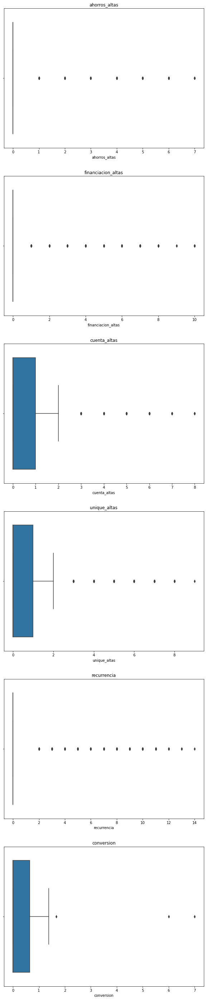

In [207]:
fig, ax = plt.subplots( len(df_final.columns), 1, figsize=(10,50) )
for col, i in zip(df_final.columns, range(len(df_final.columns))):
    #ax[i].boxplot(df_final[col], vert=False)
    sns.boxplot(ax = ax[i], x=df_final[col])
    ax[i].set_title(col)
    
plt.show()

# Model selection and construction <a class="anchor" id="3"></a>

[Tabla de Contenidos](#0)

En este apartado se selecciona y construye el modelo para permite realizar una segmentación de la cartera de clientes. En nuestro caso se opta por el algoritmo KMeans (KMedias en español). <a href="https://es.wikipedia.org/wiki/K-medias#:~:text=K%2Dmedias%20es%20un%20m%C3%A9todo,utilizado%20en%20miner%C3%ADa%20de%20datos.">KMedias</a> es un método de agrupamiento, que tiene como objetivo la partición de un conjunto de n observaciones en k grupos en el que cada observación pertenece al grupo cuyo valor medio es más cercano. 

Para la construcción del modelo se construye un pipeline. Es por ello que crear una clase con fit y transform para pasar un Array a DataFrame. 

In [208]:
class ArrayToDataFrame(BaseEstimator, TransformerMixin):
    '''
    Clase que transforma un array en un DataFrame.
    Necesita como parámetros el nombre de las columnas y el índice.
    '''
    
    def __init__(self, columns, index = None):
        self.columns = columns
        self.index = index
        
    def fit(self, X, y = None):
        return self
    
    def transform(self, X, y = None):
        
        if self.index != None:
            df = pd.DataFrame(X, columns = self.columns, index = self.index)
            
        else:
            df = pd.DataFrame(X, columns = self.columns)
            
        return df

Realizamos un backup del dataframe y nos quedamos con el nombre de las columnas y los índices.

In [209]:
# back up
X = df_final.copy(deep=True)
columns = list(X.columns)
index = list(X.index)
len(X.columns.to_list())

6

In [210]:
pipe = Pipeline(steps = [
    ("ArrayToDataFrame", ArrayToDataFrame(columns, index = index)),
    ("MinMaxScaler", MinMaxScaler())
    #("StandardScaler", StandardScaler())
])

## Selección del número óptimo de clusters <a class="anchor" id="31"></a>

[Tabla de Contenidos](#0)

El objetivo de esta sección es encontrar el número de clusters óptimo consultando la Curva del Codo (o Elbow Curve). Para ello primero se hace un fit del dataset utilizando el pipe. 

In [211]:
st = time.time()
df_scaled_transformed_no_outliers = pipe.fit_transform(X)
et = time.time()
print("Fit and transform took {} minutes.".format(round((et - st)/60), 2))

Fit and transform took 0 minutes.


In [212]:
CALCULATE_ELBOW = True

In [213]:
if CALCULATE_ELBOW:
    st = time.time()

    sse = {}

    for k in range(2, 15):

        print(f"Fitting pipe with {k} clusters")

        clustering_model = KMeans(n_clusters = k, random_state=42)

        clustering_model.fit(df_scaled_transformed_no_outliers)

        sse[k] = clustering_model.inertia_

    et = time.time()
    print("Elbow curve took {} minutes.".format(round((et - st)/60), 2))

Fitting pipe with 2 clusters
Fitting pipe with 3 clusters
Fitting pipe with 4 clusters
Fitting pipe with 5 clusters
Fitting pipe with 6 clusters
Fitting pipe with 7 clusters
Fitting pipe with 8 clusters
Fitting pipe with 9 clusters
Fitting pipe with 10 clusters
Fitting pipe with 11 clusters
Fitting pipe with 12 clusters
Fitting pipe with 13 clusters
Fitting pipe with 14 clusters
Elbow curve took 1 minutes.


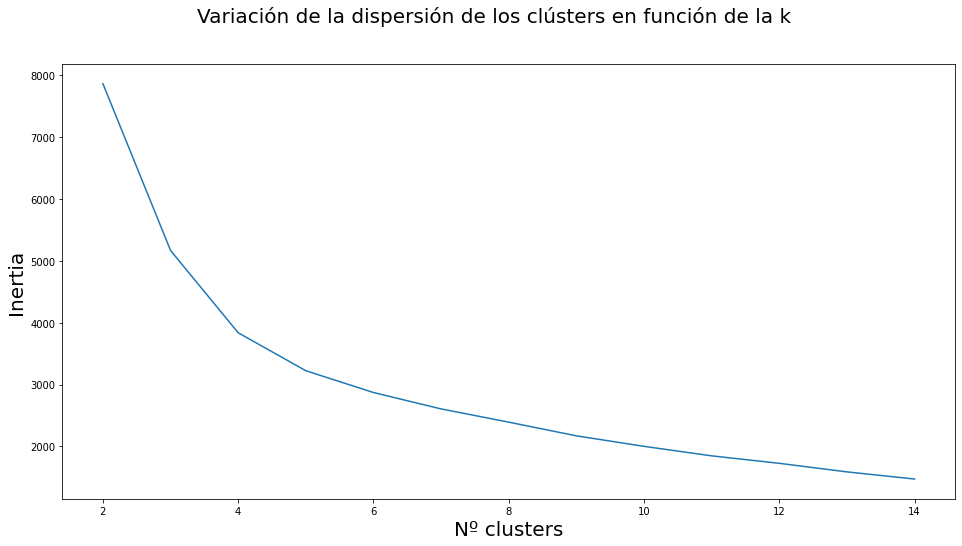

In [214]:
if CALCULATE_ELBOW:
    fig = plt.figure(figsize = (16, 8))
    ax = fig.add_subplot()

    x_values = list(sse.keys())
    y_values = list(sse.values())

    ax.plot(x_values, y_values, label = "Inertia/dispersión de los clústers")
    plt.xlabel('Nº clusters',fontsize = 20)
    plt.ylabel('Inertia',fontsize = 20)
    fig.suptitle("Variación de la dispersión de los clústers en función de la k", fontsize = 20);

Si se observa la gráfica del codo, el número óptimo de clusters sería de 5. Pese a que en el enunciado del ejercicio se sugerían 7 o 8 clusters se opta por 6 clusters por varias razones. Con 7 clusters, aparecen clusters de tan sólo 3500 clientes lo que indica que es un cluster muy particular y que probablemente este pueda ser combinado con otro por las semejanzas que tienen. Y la principal razón de escoger 6 es que los clusters que aparecen tienen un buen significado y resultan interesantes para el negocio.

Tras más de 10 clusterizaciones con diferentes variables, este resultado se considera como satisfactorio y creemos que estos grupos permiten a los empleados de la compañía entender mejor a sus clientes. 

## Clusterización y definición de los clusters <a class="anchor" id="32"></a>

[Tabla de Contenidos](#0)

Tras seleccionar el número de clusters ideal, se realiza la clusterización y se visualizan los clusters. En este caso aparece un cluster con la mayoría de clientes que son los que no han comprado nada en las particiones que se tienen. 

In [215]:
X = df_final.copy(deep=True)
columns = list(X.columns)
index = list(X.index)

normalized = pipe.fit_transform(X)

clustering_model = KMeans(n_clusters = 6, random_state=1234)
clustering_model.fit(normalized)

#print(clustering_model.cluster_centers_)
print(clustering_model.inertia_)

2933.455227436782


In [216]:
labels = clustering_model.predict(normalized)
X['cluster'] = labels
X['cluster'] += 1
X['cluster'].value_counts()

1    296891
2    109899
3     15698
4     14308
6     13984
5      5593
Name: cluster, dtype: int64

A continuación se recuperan algunas columnas del dataframe origen con el fin de poder visualizar diferencias extras entre los diferentes clusters. 

In [217]:
copy_cols = ['gastado','unique_altas','age','active_customer','tiempo_entre_compras','ahorros_altas','financiacion_altas','cuenta_altas','permanencia']
for col in copy_cols:
    if col not in X.columns.to_list():
        X[col] = df[col] 

In [218]:
X['ing_potencial'] = X['ahorros_altas']*40 + X['financiacion_altas']*60 + X['cuenta_altas']*10   

if 'conversion' not in X.columns.to_list():
    X['conversion'] = X['gastado'] / X['ing_potencial'] 
    X.replace([np.inf, -np.inf], np.nan, inplace=True)
    X['conversion'].fillna(0,inplace=True)

X['altas'] = X['ahorros_altas'] + X['financiacion_altas'] + X['cuenta_altas']
X['ahorros_pct'] =  X['ahorros_altas'] / X['altas'] 
X['financiacion_pct'] =  X['financiacion_altas'] / X['altas'] 
X['cuentas_pct'] =  X['cuenta_altas'] / X['altas'] 

if 'recurrencia' not in X.columns.to_list():
    X['recurrencia'] = X['altas'] / X['unique_altas'] - 1

X.fillna(0,inplace=True)

In [219]:
cols = list(X.columns)
cols.remove('cluster')
#cols.remove('salary')

pt = pd.pivot_table( X, index='cluster', values = cols, aggfunc='mean')

add = pd.pivot_table( X, index='cluster', values = 'gastado', aggfunc='count')
pt['count'] = add
cols.append('count')

add = pd.pivot_table( X, index='cluster', values = 'gastado', aggfunc='sum')
pt['total_gastado'] = add
pt['total_gastado_pct'] = pt['total_gastado']/pt['total_gastado'].sum()
cols.append('total_gastado')

cols = ['altas','ahorros_pct','financiacion_pct','cuentas_pct','unique_altas','recurrencia','gastado','total_gastado_pct','conversion','count']

pt.fillna(0, inplace=True)

pt[cols].style.background_gradient(cmap='coolwarm').set_precision(3)

,altas,ahorros_pct,financiacion_pct,cuentas_pct,unique_altas,recurrencia,gastado,total_gastado_pct,conversion,count
cluster,,,,,,,,,,
1,0.016,0.000,0.016,0.000,0.016,0.000,0.000,0.000,0.000,296891
2,1.159,0.000,0.096,0.904,1.135,0.045,15.217,0.358,0.860,109899
3,3.942,0.232,0.179,0.589,3.318,1.141,65.327,0.219,0.626,15698
4,3.545,0.020,0.858,0.122,1.563,3.079,54.373,0.166,0.317,14308
5,5.360,0.593,0.220,0.187,2.698,4.137,94.044,0.113,0.473,5593
6,2.074,0.634,0.079,0.286,1.934,0.282,48.007,0.144,0.738,13984


- **Cluster 1: (Los Fosa de las Marianas)** (296891) 
Este cluster representa un gran reto para todo el equipo de easyMoney, al contener el 65% de nuestros clientes captados de manera inicial pero sin conversión ya que no completan los tiempos de permanencia para poder facturar el producto contratado. 
Tenemos la ventaja de haberlos captado inicialmente y debemos identificar por que no compran, cual fue su motivación inicial en afiliarse y por que no se cumplieron sus expectativas? Debemos lograr incrementar la tasa de conversión en este cluster, por lo que puede implicar un caso de estudio específico. 

    La Fosa de las Marianas es un sitio en el óceano pacífico que aún no ha podido ser explorado. Uno de los pocos sitios a los que el ser humano no ha conseguido poder explorar aún.

- **Cluster 2: (Los Once-in-a-lifetime)** (109899)
Clientes que se dieron de alta con una cuenta (em_acount) y no volvieron a contratar nada más. Su aporte a los ingresos ha sido muy alto pero el interés por los productos de la compañía es prácticamente nulo.


- **Cluster 3: (Los Curiosos)** (15698)
Clientes que les gusta darse de alta en muchos productos y en productos de tipos distintos. Su conversión es bastante alta del 63%. Es un grupo que gasta alrededor de 70 euros de media.

- **Cluster 4: (Los Wannabe)** (14308)
Clientes que se dan de alta en los productos más caros, los de financiación y que no terminan pagándose. Es el grupo con peor conversión. Pese a no comprarlos siempre vuelven a solicitarlos más tarde, tienen una alta recurrencia. 

- **Cluster 5: (Los Más-vale-mal-conocido)** (13984)
Clientes que siempre contratan los mismos productos varias veces, especialmente los de ahorros. Es el grupo con la recurrencia más alta, han contratado 4 veces el mismo producto de media. Es el grupo que más gasta de media, su conversión es del 47% y es el grupo más pequeño.

- **Cluster 6: (Los Comprometidos)** (5593)
Clientes que tan sólo se han dado de alta en 2 productos de media, pero los han terminado pagando. Tienen una conversión muy alta del 73%. 


**Conclusiones**

Clusters 3 y 6, serán los elegidos para nuestra campaña inicial de email marketing, debido a su engagement más elevado en una variedad de productos más amplia, lo cual nos permite elaborar un modelo de recomendación mucho más preciso lo que nos puede permitir un aumento de facturación a corto plazo.

Los cluster 1 y 2 representan el 89% de nuestra BD de clientes con 406790. Para estos cluster pudiéramos hacer, en una segunda etapa, un análisis específico para recuperarlos / aumentar su engagement. 

El análisis deberá incluir información demográfica externa ya que su histórico con nosotros no aporta mucha información útil, sin embargo pudiéramos plantear de manera inicial una recomendación basada en popularidad de productos, para lo cual tendríamos los siguientes 2 escenarios:
- Cluster 1: Fidelizarlos con nuestro producto estrella “em_account” el cual suele ser el primer producto contratado por el resto de nuestros clientes. Con un 20% de engagement en este producto para este cluster puede significar un aumento de ingresos de aproximadamente 500k €
- Cluster 2: Ya que estos clientes se han dado de alta en su mayoría con productos de categoría “Cuentas” podríamos enfocar nuestro esfuerzo en aumentar el engagement en productos de “financiación” como nuestro segundo producto más vendido “debit_card”. Siguiendo el mismo objetivo de crecimiento del 20% esto representaría ingresos appx por 1.3M €

Por lo tanto con un potencial de casi 2M € y 400k registros de clientes, es interesante como un siguiente proyecto a enfocarse.

Para los Cluster 4 y 5 tenemos una población menor, solo 28292 clientes en total. Sin embargo se enfocan en los productos de mayor valor (Ahorros y Financiación) por lo que si aumentamos su engagement en un 20% representaría 280k € más de ingresos.  

Guardamos el assigment de cada cliente a cada cluster en un csv, para así poder leer los resultados en otra tarea o notebook. 

In [220]:
run = True
if run == True:
    X_ = X.copy(deep=True)
    X_['pk_cid'] = df['pk_cid'] 
    X_[['pk_cid','cluster']].to_csv('client_segmentation.csv')

In [221]:
#X.fillna(0,inplace=True)
run = True
if run == True:
    X.to_pickle('cluster_segmentation.pkl')

In [223]:
cluster = 3
X[X['cluster']==cluster][['conversion']].describe()

,conversion
count,15698.000000
mean,0.626298
std,0.331529
min,0.000000
25%,0.333333
50%,0.687500
75%,0.916667
max,1.375000


## Evaluación de la clusterización <a class="anchor" id="33"></a>

[Tabla de Contenidos](#0)

Uno podría decir que el mejor modelo es el que menor inercia tiene, sin embargo a medida que aumentan los clusters obviamente la suma de las distancias al cluster más cercano disminuyen, es por ello que se visualiza la Elbow Curve. Esta técnica es un poco vulgar, existe otra manera pero que resulta ser mucho más demandante computacionalmente. <a href="https://www.amazon.es/Hands-Machine-Learning-Scikit-Learn-TensorFlow/dp/1491962291">Aurélien Géron. “Hands-On Machine Learning with Scikit-Learn, Keras, and TensorFlow”</a>. 

Esta técnica es el Silhouette score, que es la media del coeficiente silhouette sobre todos los registros. El coeficiente silhouette de un registro es igual a (b – a) / max(a, b), donde a es la distancia media a los registros en ese cluster (the mean intra-cluster distance) y b es la distancia media al cluster más próximo (es decir la distancia media los registros del siguiente cluster, siendo el registro que minimza b exluyendo las instancias en el mismo clsuter). 

El coeficiente de silhouette puede tomar valores entre -1 y +1. Un coeficiente cercano a +1 significa que el registro está bien dentro de su cluster y está lejano a otros clusters, mientras que un coeficiente cercano a 0 indica que el registro está cercano a la frontera del cluster, mientras que un valor cercano a -1 indica que el registro ha sido asignado al cluster equivocado. 

A continuación se obtiene el Diagrama de Silhouette; cada cuchillo indica cada cluster, la altura de cada uno indica la cantidad de registros que el cluster contiene, y su anchura representa los coeficientes de silhouette ordenador (cuánto más ancho mejor). La línea entre cortada indica la media del coeficiente de silhouette. 

In [224]:
cols = show_columns
X_normalized = pd.DataFrame(normalized, columns = cols)

In [225]:
from sklearn.metrics import silhouette_samples, silhouette_score

import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np


range_n_clusters = [5, 6, 7, 8, 9]
range_n_clusters = [6]

run = False
if run == True:
    for n_clusters in range_n_clusters:
        # Create a subplot with 1 row and 1 column
        fig, ax1 = plt.subplots(1, 1)
        fig.set_size_inches(15, 7)

        # The 1st subplot is the silhouette plot
        # The silhouette coefficient can range from -1, 1 but in this example all
        # lie within [-0.1, 1]
        ax1.set_xlim([-0.1, 1])
        # The (n_clusters+1)*10 is for inserting blank space between silhouette
        # plots of individual clusters, to demarcate them clearly.
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])
        
        # Initialize the clusterer with n_clusters value and a random generator
        # seed of 10 for reproducibility.
        clusterer = KMeans(n_clusters=n_clusters, random_state=1234)
        cluster_labels = clusterer.fit_predict(X_normalized)

        # The silhouette_score gives the average value for all the samples.
        # This gives a perspective into the density and separation of the formed
        # clusters
        silhouette_avg = silhouette_score(X_normalized, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X_normalized, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cm.nipy_spectral(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([])  # Clear the yaxis labels / ticks
        ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

        # Labeling the clusters
        centers = clusterer.cluster_centers_

        plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                      "with n_clusters = %d" % n_clusters),
                     fontsize=14, fontweight='bold')

    plt.show()

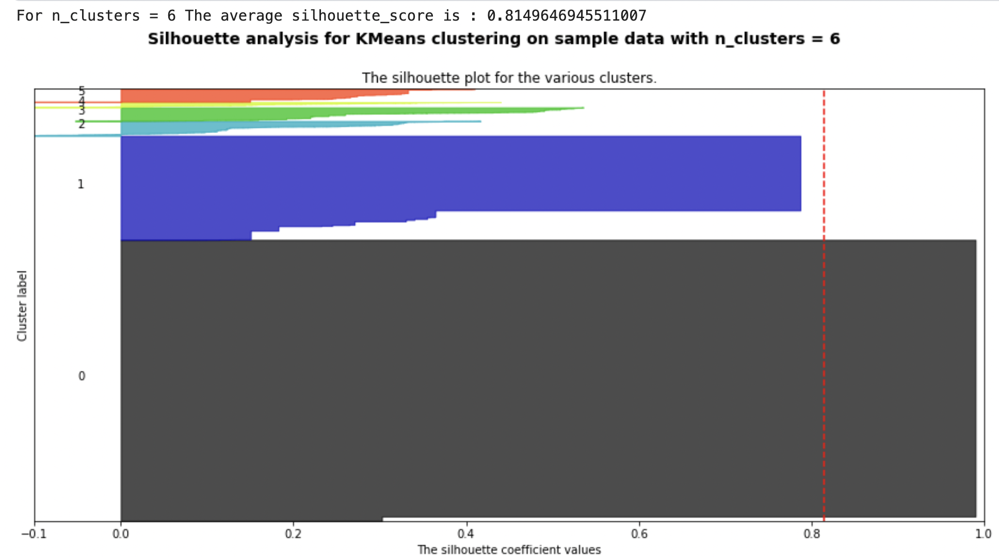

In [226]:
from IPython.display import Image
Image(filename=PATH_DATA+'cuchillos.png') 

In [227]:
obtain = True
if obtain == True:
    fig.savefig('cuchillos.png')

La interpretación que se puede realizar del Diagrama de Silhouette es que cuando los valores del coeficiente están por debajo del score medio representado con la línea vertical roja entrecortada, indica que el cluster no es idóneo dado que muchas de sus instancias están bastante cerca de las de otros clusters. Idealmente una clusterización ideal, todos los cuchillos deberían sobrepasar por la derecha la línea vertical.

En nuetro caso el diagrama de Silhouette indica que los clusters no son los idóneos, esto muy probablemente se debe a que hay un cluster enrome con todos los cleintes que no realizaron ninguna compra. 

# Preparación del dashboard <a class="anchor" id="4"></a>

[Tabla de Contenidos](#0)

Finalmente en este apartado se obtienen una serie de funciones y gráficas que permitirían visualizar los resultados en el dashboard. Primero, se asigna un nombre y un color a cada cluster y se guarda en un diccionario.

Seguidamente se realiza una función para visualizar la información de los diferentes clusters. 

In [228]:
cluster_names = {0:'Los Perdidos',1:'Los Once-in-a-lifetime',2:'Los Curiosos',3:'Los Wannabe',4:'Los Más-vale-mal-conocido',5:'Los Comprometidos'}
cluster_colors = {0:'lightblue',1:'indianred',2:'orange',3:'lightseagreen',4:'mediumpurple',5:'darkgray'}

cluster_info = {}
cluster_info['names'] = cluster_names
cluster_info['colors'] = cluster_colors

In [229]:
def plot_clusters(X, selected_clusters, variable, type_plot, cluster_info):
    fig = go.Figure()
    names = cluster_info['names']
    colors = cluster_info['colors']

    for cluster in selected_clusters:
        if type_plot == 'Violin':
            fig.add_trace(go.Violin(x = X[X['cluster']==cluster][variable], name='Cluster '+names[cluster],
                                   line_color=colors[cluster] ))
        elif type_plot == 'Box':
            fig.add_trace(go.Box(x = X[X['cluster']==cluster][variable], name='Cluster '+names[cluster],
                                 line_color=colors[cluster]))

    fig.update_layout(legend=dict(
          orientation="h", yanchor="bottom", y=1.02,
          xanchor="center", x=0.5,
          font=dict(family="Courier",size=14,color="black")
      ),margin=go.layout.Margin(
            l=20, #left margin
            r=20, #right margin
            b=20, #bottom margin
            t=20  #top margin
      ))
    
    return fig

In [230]:
fig = plot_clusters(X, range(6), "recurrencia", "Violin", cluster_info)
fig.update_xaxes(title="Recurrencia")
fig.show()

In [231]:
fig = plot_clusters(X, range(6), "active_customer", "Box", cluster_info)
fig.update_xaxes(title="Active Customer")
fig.show()

In [232]:
fig = plot_clusters(X, range(6), "unique_altas", "Box", cluster_info)
fig.update_xaxes(title="Altas distintas")
fig.show()

In [233]:
fig = plot_clusters(X, range(6), "tiempo_entre_compras", "Violin", cluster_info)
fig.update_xaxes(title="Tiempo entre compras")
fig.show()

In [234]:
cluster=5
X_ = X[X['cluster']==cluster]
X_melted = pd.melt(X_, value_vars=['ahorros_altas','financiacion_altas','cuenta_altas'])
X_melted

,variable,value
0,ahorros_altas,3
1,ahorros_altas,5
2,ahorros_altas,3
3,ahorros_altas,4
4,ahorros_altas,3
...,...,...
16774,cuenta_altas,2
16775,cuenta_altas,2
16776,cuenta_altas,2
16777,cuenta_altas,1


In [235]:
fig = go.Figure()
#ahorros_altas financiacion_altas cuenta_altas

fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'ahorros_altas']['variable'],
                            y=X_melted[X_melted['variable'] == 'ahorros_altas']['value'],
                            legendgroup='Ahorros', scalegroup='Ahorros', name='Ahorros',
                            line_color='orange')
             )
fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'financiacion_altas']['variable'],
                            y=X_melted[X_melted['variable'] == 'financiacion_altas']['value'],
                            legendgroup='Financiacion', scalegroup='Financiacion', name='Financiacion',
                            line_color='blue')
             )
fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'cuenta_altas']['variable'],
                            y=X_melted[X_melted['variable'] == 'cuenta_altas']['value'],
                            legendgroup='Cuentas', scalegroup='Cuentas', name='Cuentas',
                            line_color='red')
             )

fig.update_traces(box_visible=True, meanline_visible=True)
fig.update_layout(violinmode='group')
fig.show()

In [236]:
fig = go.Figure()

for cluster in range(7):
    X_ = X[X['cluster']==cluster]
    X_melted = pd.melt(X_, value_vars=['ahorros_altas','financiacion_altas','cuenta_altas'])
    
    fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'ahorros_altas']['variable'],
                            y=X_melted[X_melted['variable'] == 'ahorros_altas']['value'],
                            legendgroup='Ahorros', scalegroup='Ahorros', name='Ahorros'+str(cluster),
                            line_color='orange')
             )
    fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'financiacion_altas']['variable'],
                                y=X_melted[X_melted['variable'] == 'financiacion_altas']['value'],
                                legendgroup='Financiacion', scalegroup='Financiacion', name='Financiacion',
                                line_color='blue')
                 )
    fig.add_trace(go.Violin(x=X_melted[X_melted['variable'] == 'cuenta_altas']['variable'],
                                y=X_melted[X_melted['variable'] == 'cuenta_altas']['value'],
                                legendgroup='Cuentas', scalegroup='Cuentas', name='Cuentas',
                                line_color='red')
                 )

#fig.update_traces(box_visible=True, meanline_visible=True)
fig.update_layout(violinmode='group')
fig.show()

# Conclusiones <a class="anchor" id="5"></a>

[Tabla de Contenidos](#0)

Tras haber realizado la Tarea 2, donde el objetivo era realizar una segmentación de nuestra cartera de clientes los resultados son satisfactorios. Se ha observado que la parte más importante en la segmentación es la preparación de los atributos y qué significado tienen estos para el negocio. En nuestro caso, el objetivo de la segmentación era obtener diferentes grupos según su actividad comercial. 

Es por ello que se seleccionan cuidadosamente que variables se introducen al modelo de clusterización. Se probaron más de 10 clusters y este fue el resultado que mejor sentido y significado para el negocio tenía. En las primeras iteraciones, se introdujeron variables como edad o provincia, y aparecían 2 clusters idénticos: mismos gustos e intereses, misma cantidad gastada pero que únicamente se diferenciaban que uno vivía en Madrid y otro no; lo que resultaba ser un poco estridente. 

Finalmente se escogieron 6 clusters porque los clusters que aparecen son bastante diferentes en cuanto a su significado, aunque el diagrama de Silhouette indique lo contrario. Esta segmentación podrá ser utilizada en otras tareas.